# 🌊 Wave Physics

This notebook introduces the fundamental concepts of wave physics and solves the 1D wave equation using both analytical and numerical methods.

We'll use Python and Seaborn/Matplotlib to visualize:
- Harmonic waves
- Standing waves
- FDTD simulation of a vibrating string
- An animation of wave propagation

## References
- Achenbach, J. D. (2012). *Wave Propagation in Elastic Solids*. North-Holland.
- LeVeque, R. J. (2007). *Finite Difference Methods for Ordinary and Partial Differential Equations*. SIAM.
- Wikipedia: [Wave Equation](https://en.wikipedia.org/wiki/Wave_equation)

## Harmonic waves

A **wave** is a disturbance that transfers energy from one place to another without transferring matter. In physics, waves are classified as mechanical (requiring a medium, like sound or water waves) or electromagnetic (which can travel through a vacuum, like light).

### Key Properties of Waves

- **Amplitude ($A$):** The maximum displacement from the equilibrium position. It determines the wave's energy.
- **Wavelength ($\lambda$):** The distance between two consecutive points in phase (e.g., crest to crest).
- **Frequency ($f$):** The number of oscillations per second (measured in Hz).
- **Period ($T$):** The time for one complete oscillation ($T = 1/f$).
- **Wave speed ($v$):** The speed at which the wave propagates ($v = f\lambda$).

### Mathematical Description

A basic **harmonic (sinusoidal) wave** traveling in one dimension can be described by:

$$
u(x, t) = A \sin(kx - \omega t)
$$

where:
- $u(x, t)$ is the displacement at position $x$ and time $t$
- $A$ is the amplitude  
- $k = \frac{2\pi}{\lambda}$ is the wavenumber  
- $\omega = 2\pi f$ is the angular frequency  
- The term $(kx - \omega t)$ describes a wave moving in the $+x$ direction

The **wave speed** is related to these parameters by:

$$
v = \frac{\omega}{k} = f\lambda
$$

### Types of Waves

- **Transverse waves:** Displacement is perpendicular to the direction of propagation (e.g., waves on a string, electromagnetic waves).
- **Longitudinal waves:** Displacement is parallel to the direction of propagation (e.g., sound waves).

## Standing Waves

A **standing wave** is formed by the superposition of two waves of the same frequency and amplitude traveling in opposite directions. The result is a pattern of nodes (points of zero displacement) and antinodes (points of maximum displacement):

$$
u(x, t) = 2A \sin(kx) \cos(\omega t)
$$

- **Nodes:** Points where $\sin(kx) = 0$ (no motion)
- **Antinodes:** Points where $|\sin(kx)|$ is maximized (maximum motion)

### In a nutshell

- **Traveling waves** move energy and information from one place to another.
- **Standing waves** do not transfer energy along the medium but store energy in fixed patterns.

Understanding these fundamental concepts is essential for exploring more complex wave phenomena in physics, engineering, and beyond.

In [4]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Parameters for standing wave
A_standing = 1.0
k_standing = 2 * np.pi / 1.0  # wavelength = 1.0
omega_standing = 2 * np.pi * 1.0  # frequency = 1.0 Hz

x_standing = np.linspace(0, 2, 500)  # 2 wavelengths
t_max = 2.0
frames = 100
dt_anim = t_max / frames

fig, ax = plt.subplots(figsize=(8, 3))
line_standing, = ax.plot([], [], 'b-', lw=3, label='Standing Wave')
line_envelope1, = ax.plot([], [], 'r--', lw=1, alpha=0.7, label='Envelope +')
line_envelope2, = ax.plot([], [], 'r--', lw=1, alpha=0.7, label='Envelope -')

ax.set_xlim(0, 2)
ax.set_ylim(-2.5, 2.5)
ax.set_xlabel('Position (x)')
ax.set_ylabel('Displacement')
ax.set_title('Standing Wave Animation: u(x,t) = 2A sin(kx) cos(ωt)')
ax.grid(False)
ax.legend(loc='upper right')

# Add vertical lines at nodes
node_positions = np.arange(0, 2.1, 0.5)  # nodes at x = 0, 0.5, 1.0, 1.5, 2.0
for node_x in node_positions:
    ax.axvline(x=node_x, color='gray', linestyle=':', alpha=0.5)

def init_standing():
    line_standing.set_data([], [])
    line_envelope1.set_data([], [])
    line_envelope2.set_data([], [])
    return line_standing, line_envelope1, line_envelope2

def animate_standing(frame):
    t = frame * dt_anim
    
    # Standing wave equation: u(x,t) = 2A sin(kx) cos(ωt)
    y_standing = 2 * A_standing * np.sin(k_standing * x_standing) * np.cos(omega_standing * t)
    
    # Envelope functions
    envelope_pos = 2 * A_standing * np.sin(k_standing * x_standing)
    envelope_neg = -2 * A_standing * np.sin(k_standing * x_standing)
    
    line_standing.set_data(x_standing, y_standing)
    line_envelope1.set_data(x_standing, envelope_pos)
    line_envelope2.set_data(x_standing, envelope_neg)
    
    return line_standing, line_envelope1, line_envelope2

anim_standing = FuncAnimation(fig, animate_standing, frames=frames,
                             init_func=init_standing, blit=True, interval=50)

fig.tight_layout()
plt.close(fig)
HTML(anim_standing.to_jshtml())

## Derivation of the 1D Wave Equation

The **1D wave equation** describes how waves propagate through a medium, such as vibrations on a string:

$$
\frac{\partial^2 u}{\partial t^2} = c^2 \frac{\partial^2 u}{\partial x^2}
$$


Consider a small segment of a stretched string under tension $T$ and with linear mass density $\mu$. Let $u(x, t)$ be the transverse displacement at position $x$ and time $t$.

1. **Force Analysis:**

    The net vertical force on a segment of length $\Delta x$ is due to the difference in the vertical components of the tension at each end:
    $$
    F = T \sin\theta(x+\Delta x) - T \sin\theta(x)
    $$
    For small angles, $\sin\theta \approx \frac{\partial u}{\partial x}$, so:
    $$
    F \approx T \left[ \frac{\partial u}{\partial x}\Big|_{x+\Delta x} - \frac{\partial u}{\partial x}\Big|_{x} \right] = T \frac{\partial^2 u}{\partial x^2} \Delta x
    $$

2. **Newton's Second Law:**

    The mass of the segment is $\mu \Delta x$, and its vertical acceleration is $\frac{\partial^2 u}{\partial t^2}$:
    $$
    F = \mu \Delta x \frac{\partial^2 u}{\partial t^2}
    $$

3. **Combine and Simplify:**

    $$
    T \frac{\partial^2 u}{\partial x^2} \Delta x = \mu \Delta x \frac{\partial^2 u}{\partial t^2}
    $$
    $$
    \frac{\partial^2 u}{\partial t^2} = \frac{T}{\mu} \frac{\partial^2 u}{\partial x^2}
    $$
    Define $c = \sqrt{T/\mu}$ as the wave speed:
    $$
    \frac{\partial^2 u}{\partial t^2} = c^2 \frac{\partial^2 u}{\partial x^2}
    $$


## Discretization: Finite Difference Time Domain (FDTD)

To solve numerically, we can discretize $x$ and $t$:
- $u_i^n$ is the displacement at position $x_i$ and time $t_n$
- $\Delta x$ is the spatial step, $\Delta t$ is the time step

The second derivatives are approximated as:
- Time: $\frac{\partial^2 u}{\partial t^2} \approx \frac{u_i^{n+1} - 2u_i^n + u_i^{n-1}}{(\Delta t)^2}$
- Space: $\frac{\partial^2 u}{\partial x^2} \approx \frac{u_{i+1}^n - 2u_i^n + u_{i-1}^n}{(\Delta x)^2}$

Plug into the wave equation:
$$
\frac{u_i^{n+1} - 2u_i^n + u_i^{n-1}}{(\Delta t)^2} = c^2 \frac{u_{i+1}^n - 2u_i^n + u_{i-1}^n}{(\Delta x)^2}
$$

Rearrange for $u_i^{n+1}$:
$$
u_i^{n+1} = 2u_i^n - u_i^{n-1} + r^2 (u_{i+1}^n - 2u_i^n + u_{i-1}^n)
$$
where $r = \frac{c \Delta t}{\Delta x}$ is the **Courant number** (must satisfy $r \leq 1$ for stability).

Or, equivalently:
$$
u_i^{n+1} = 2(1 - r^2)u_i^n - u_i^{n-1} + r^2(u_{i+1}^n + u_{i-1}^n)
$$

### Boundary Conditions for the 1D Wave Equation

When solving the 1D wave equation numerically, the choice of boundary conditions at the ends of the domain is crucial. The main types are:

- **Dirichlet (Fixed) Boundary Conditions:**  
    The displacement at the boundaries is held fixed, typically at zero:
    $$
    u(0, t) = u(L, t) = 0
    $$
    This models a string fixed at both ends.

- **Neumann (Free) Boundary Conditions:**  
    The spatial derivative (slope) at the boundaries is set to zero:
    $$
    \frac{\partial u}{\partial x}\Big|_{x=0} = \frac{\partial u}{\partial x}\Big|_{x=L} = 0
    $$
    This corresponds to a string with free ends (no force at the boundaries).

- **Periodic Boundary Conditions:**  
    The solution and its derivatives are the same at both ends:
    $$
    u(0, t) = u(L, t), \quad \frac{\partial u}{\partial x}\Big|_{x=0} = \frac{\partial u}{\partial x}\Big|_{x=L}
    $$
    This is useful for modeling waves on a loop or ring.

- **Absorbing (Non-Reflecting) Boundary Conditions:**  
    Designed to minimize artificial reflections at the boundaries, simulating an open domain. These are more complex and often use special numerical techniques.

**Summary:**  
- Fixed (Dirichlet): $u=0$ at boundaries  
- Free (Neumann): $\partial u/\partial x=0$ at boundaries  
- Periodic: $u$ and $\partial u/\partial x$ match at both ends  
- Absorbing: minimize reflections, approximate open space

The choice depends on the physical situation you want to model.

### Wave Equation with Damping and Dispersion

The standard 1D wave equation is:
$$
\frac{\partial^2 u}{\partial t^2} = c^2 \frac{\partial^2 u}{\partial x^2}
$$

#### Adding Damping

Damping models energy loss (e.g., due to friction or air resistance). The most common form is linear damping, proportional to velocity:
$$
\frac{\partial^2 u}{\partial t^2} + \gamma \frac{\partial u}{\partial t} = c^2 \frac{\partial^2 u}{\partial x^2}
$$
- $\gamma$ is the damping coefficient.

#### Adding Dispersion

Dispersion accounts for frequency-dependent wave speed, often modeled by a fourth spatial derivative:
$$
\frac{\partial^2 u}{\partial t^2} + \gamma \frac{\partial u}{\partial t} = c^2 \frac{\partial^2 u}{\partial x^2} - \alpha \frac{\partial^4 u}{\partial x^4}
$$
- $\alpha$ is the dispersion coefficient.

#### Discretized (FDTD) Form

For numerical simulation, the equation can be discretized as:
$$
u_i^{n+1} = 2u_i^n - u_i^{n-1} + r^2 (u_{i+1}^n - 2u_i^n + u_{i-1}^n) - \gamma \Delta t (u_i^n - u_i^{n-1}) + \alpha (\Delta t)^2 (u_{i+2}^n - 4u_{i+1}^n + 6u_i^n - 4u_{i-1}^n + u_{i-2}^n) / (\Delta x)^4
$$

- The $\gamma$ term damps the wave.
- The $\alpha$ term introduces dispersion.

In [5]:
def solve_wave_equation(L=1.0, T=2.0, Nx=200, Nt=500, c=1.0, 
                       initial_condition=None, boundary_type='dirichlet',
                       damping=0.0, dispersion=0.0):
    """
    Solve the 1D wave equation using FDTD method.
    
    Parameters:
    -----------
    L : float
        Length of domain
    T : float  
        Total simulation time
    Nx : int
        Number of spatial points
    Nt : int
        Number of time steps
    c : float
        Wave speed
    initial_condition : function or None
        Function u(x) for initial displacement. If None, uses Gaussian pulse.
    boundary_type : str
        'dirichlet' (fixed), 'neumann' (free), or 'periodic'
    damping : float
        Damping coefficient γ
    dispersion : float
        Dispersion coefficient α
        
    Returns:
    --------
    u : ndarray
        Wave field u(t, x) with shape (Nt, Nx)
    x : ndarray
        Spatial coordinates
    t : ndarray
        Time coordinates
    """
    
    # Setup grid
    dx = L / (Nx - 1)
    dt = T / Nt
    x = np.linspace(0, L, Nx)
    t = np.linspace(0, T, Nt)
    
    # Stability check
    r = c * dt / dx
    if r > 1.0:
        raise ValueError(f"Unstable: Courant number r = {r:.3f} > 1.0")
    
    # Initialize arrays
    u = np.zeros((Nt, Nx))
    
    # Initial condition
    if initial_condition is None:
        # Default: Gaussian pulse at center
        u[0, :] = np.exp(-1000 * (x - L/2)**2)
    else:
        u[0, :] = initial_condition(x)
    
    # Second time step (needed for leap-frog scheme)
    u[1, 1:-1] = u[0, 1:-1] + 0.5 * r**2 * (u[0, 2:] - 2*u[0, 1:-1] + u[0, :-2])
    
    # Apply boundary conditions to second time step
    u[1] = _apply_boundaries(u[1], boundary_type)
    
    # Time evolution
    for n in range(1, Nt - 1):
        if damping == 0.0 and dispersion == 0.0:
            # Standard wave equation
            u[n+1, 1:-1] = (2 * (1 - r**2) * u[n, 1:-1] - 
                            u[n-1, 1:-1] + 
                            r**2 * (u[n, 2:] + u[n, :-2]))
        else:
            # Wave equation with damping and/or dispersion
            u_xx = u[n, 2:] - 2*u[n, 1:-1] + u[n, :-2]
            u_t = (u[n, 1:-1] - u[n-1, 1:-1]) / dt
            
            # Damped wave equation: u_tt + γ*u_t = c²*u_xx - α*u_xxxx
            u[n+1, 1:-1] = (2*u[n, 1:-1] - u[n-1, 1:-1] + 
                            r**2 * u_xx - 
                            damping * dt * u_t)
            
            # Optional dispersion term (simplified)
            if dispersion > 0:
                if n > 2 and n < Nt - 3:  # Need extra points for 4th derivative
                    u_xxxx = (u[n, 4:-1] - 4*u[n, 3:-2] + 6*u[n, 2:-3] - 
                             4*u[n, 1:-4] + u[n, :-5])
                    u[n+1, 2:-2] -= dispersion * dt**2 * u_xxxx
        
        # Apply boundary conditions
        u[n+1] = _apply_boundaries(u[n+1], boundary_type)
    
    return u, x, t

def _apply_boundaries(u_row, boundary_type):
    """Apply boundary conditions to a single time row."""
    # Drichlet, Neumann, Absorbing, or Periodic
    if boundary_type == 'dirichlet':
        u_row[0] = 0
        u_row[-1] = 0
    elif boundary_type == 'neumann':
        u_row[0] = 2*u_row[1] - u_row[2]
        u_row[-1] = 2*u_row[-2] - u_row[-3]
    elif boundary_type == 'absorbing':
        # Simple absorbing boundaries - waves exit domain
        u_row[0] = 0
        u_row[-1] = 0
    elif boundary_type == 'periodic':
        u_row[0] = u_row[-2]
        u_row[-1] = u_row[1]
    return u_row

# Example usage functions
def gaussian_pulse(x, center=0.5, width=0.05):
    """Gaussian pulse initial condition."""
    return np.exp(-((x - center) / width)**2)

def sine_wave(x, wavelength=0.5):
    """Sine wave initial condition."""
    return np.sin(2 * np.pi * x / wavelength)

def step_function(x, step_pos=0.3):
    """Step function initial condition."""
    return np.where(x < step_pos, 1.0, 0.0)

## Visualizing colliding waves

In the next simulations, we will see how gaussian pulses interfere with each other. 
As they propagate, the waves eventually meet and overlap. The principle of superposition applies: the total displacement at each point is simply the sum of the displacements from each wave. In the absence of damping or dispersion, the waves continue traveling, retaining their original shapes.

This behavior is a hallmark of linear wave equations and demonstrates that waves can interact without permanently affecting each other.

### Heatmaps
The heatmap shows how the wave evolves in space and time simultaneously. Diagonal lines in the heatmap correspond to waves moving left and right. The initial Gaussian pulse splits into two waves traveling in opposite directions. When these waves hit the boundaries at \(x=0\) and \(x=1\), they reflect back. Red regions indicate positive displacement, while blue regions indicate negative displacement.


In [6]:
def heatmap(u, x, t, title="Wave Propagation"):
    """
    Visualize wave propagation using a space-time heatmap and time snapshots.
    
    Creates two plots: a heatmap showing wave evolution over space and time,
    and line plots showing the wave profile at different time instances.
    """
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

    # Extract domain dimensions and time step from the simulation data
    Nt, Nx = u.shape
    L = x[-1] - x[0]  # Domain length
    T = t[-1] - t[0]  # Total simulation time
    dt = T / (Nt - 1)

    # Automatically detect significant pulses in the initial wave field
    initial_field = u[0, :]
    pulse_threshold = 0.1 * np.max(np.abs(initial_field))  # 10% of maximum amplitude

    # Use peak detection to find both positive and negative pulse features
    from scipy.signal import find_peaks
    
    pos_peaks, _ = find_peaks(initial_field, height=pulse_threshold)
    neg_peaks, _ = find_peaks(-initial_field, height=pulse_threshold)
    
    # Store positions and amplitudes of all detected pulses
    pulse_positions = []
    pulse_amplitudes = []
    
    for peak_idx in pos_peaks:
        pulse_positions.append(x[peak_idx])
        pulse_amplitudes.append(initial_field[peak_idx])
    
    for peak_idx in neg_peaks:
        pulse_positions.append(x[peak_idx])
        pulse_amplitudes.append(initial_field[peak_idx])

    # Create space-time heatmap showing wave evolution
    downsample = 5  # Reduce data density for cleaner visualization
    u_sampled = u[::downsample, :]

    im1 = ax1.imshow(u_sampled, cmap="RdBu_r", aspect='auto', origin='lower',
                    extent=[x[0], x[-1], t[0], t[-1]], vmin=-0.5, vmax=0.5)
    ax1.set_title(f"{title}\nHeatmap (FDTD)", fontsize=12)
    ax1.set_xlabel("Position (x)")
    ax1.set_ylabel("Time (t)")
    ax1.set_aspect('auto')
    ax1.grid(False)
    plt.colorbar(im1, ax=ax1, label='Displacement')

    # Add annotations for detected initial pulses with smart positioning
    if len(pulse_positions) > 0:
        # Sort pulses by position to systematically handle annotation placement
        sorted_indices = np.argsort(pulse_positions)
        
        for i, idx in enumerate(sorted_indices):
            pos = pulse_positions[idx]
            amp = pulse_amplitudes[idx]
            pulse_type = "positive" if amp > 0 else "negative"
            label = f"Initial {pulse_type}\npulse"
            
            # Use vertical staggering to prevent annotation overlap
            base_height = 0.2 + (i % 3) * 0.15  # Cycle through three height levels
            text_y = base_height * T
            
            # Position text boxes horizontally based on pulse location
            if pos < L/3:          # Left side: place text to the right
                text_x = pos + 0.15*L
            elif pos > 2*L/3:      # Right side: place text to the left
                text_x = pos - 0.15*L
            else:                  # Center: alternate left/right placement
                text_x = pos + 0.1*L if i % 2 == 0 else pos - 0.1*L
            
            # Create annotation with arrow pointing to pulse location
            ax1.annotate(label, xy=(pos, 0.05*T), xytext=(text_x, text_y),
                        arrowprops=dict(arrowstyle='->', color='black', alpha=0.8),
                        fontsize=8, ha='center', color='black',
                        bbox=dict(boxstyle="round,pad=0.3", facecolor='white', 
                                 edgecolor='black', alpha=0.9))

    # Create line plots showing wave profiles at selected time instances
    ax1.grid(False)
    ax2.grid(False)
    times_to_show = [0, Nt//6, Nt//3, 2*Nt//3, 5*Nt//6, Nt-1]
    colors = plt.cm.viridis(np.linspace(0, 1, len(times_to_show)))
    
    # Plot wave profile at each selected time
    for i, time_idx in enumerate(times_to_show):
        if time_idx < Nt:
            # Make initial condition more prominent with thicker line
            alpha = 0.8 if i == 0 else 0.6
            linewidth = 3 if i == 0 else 2
            linestyle = '-' if i == 0 else '--' if i % 2 == 1 else '-'
            
            ax2.plot(x, u[time_idx], label=f't = {t[time_idx]:.2f}s', 
                    lw=linewidth, alpha=alpha, color=colors[i], linestyle=linestyle)

    # Mark initial pulse locations
    if len(pulse_positions) > 0:
        for pos, amp in zip(pulse_positions, pulse_amplitudes):
            ax2.plot(pos, amp, 'o', markerfacecolor='red', markeredgecolor='white', 
                    markersize=6, markeredgewidth=1.5, alpha=0.9)

    # Add markers to legend by creating a dummy plot
    if len(pulse_positions) > 0:
        ax2.plot([], [], 'o', markerfacecolor='red', markeredgecolor='white', 
                markersize=6, markeredgewidth=1.5, label='Initial pulses')

    ax2.set_title("Wave at Different\nTime Snapshots", fontsize=12)
    ax2.set_xlabel("Position (x)")
    ax2.set_ylabel("Displacement")
    ax2.legend(loc='upper right', fontsize='small', ncol=1, frameon=True, framealpha=1, bbox_to_anchor=(1.15, 1.1))

    fig.tight_layout()
    plt.show()
    
    # Display summary of detected pulse characteristics
    if len(pulse_positions) > 0:
        print(f"Detected {len(pulse_positions)} initial pulse(s):")
        for i, (pos, amp) in enumerate(zip(pulse_positions, pulse_amplitudes)):
            print(f"  Pulse {i+1}: position x = {pos:.3f}, amplitude = {amp:.3f}")
    else:
        print("No significant pulses detected in initial condition")

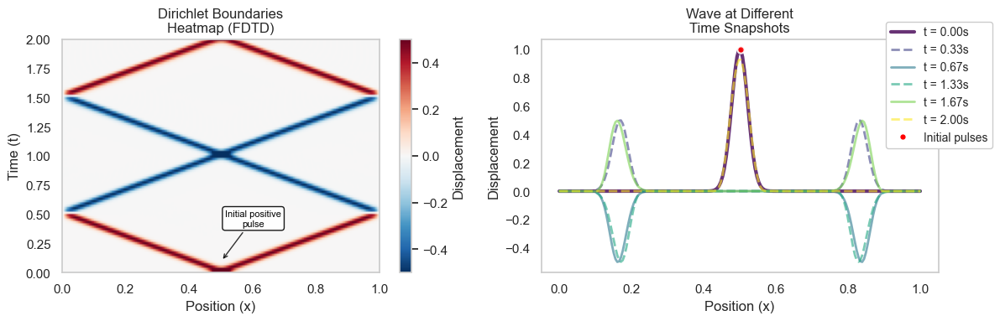

Detected 1 initial pulse(s):
  Pulse 1: position x = 0.503, amplitude = 0.994


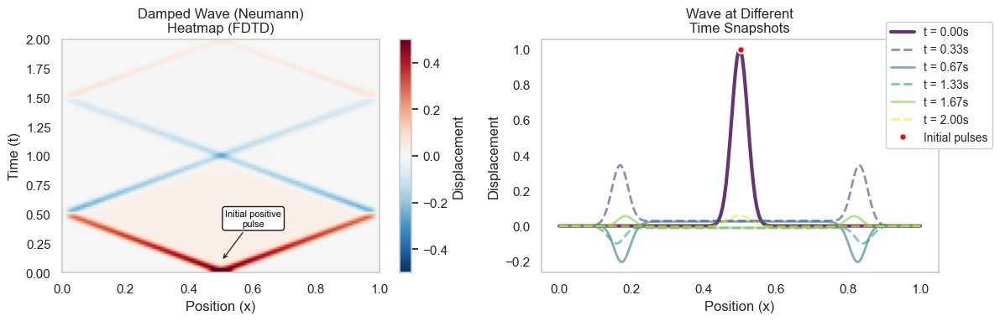

Detected 1 initial pulse(s):
  Pulse 1: position x = 0.503, amplitude = 0.994


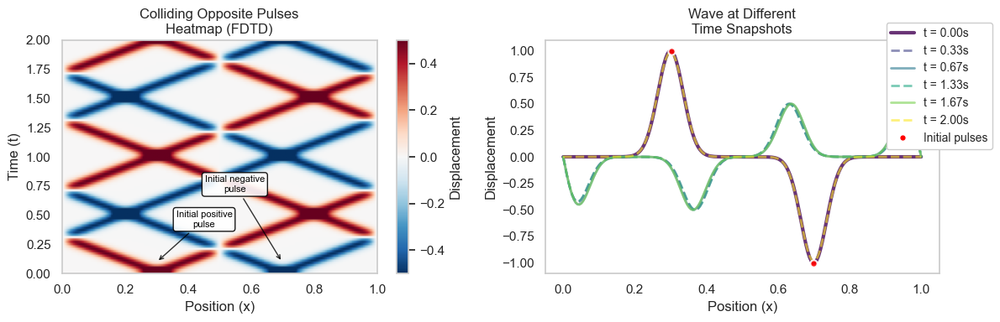

Detected 2 initial pulse(s):
  Pulse 1: position x = 0.302, amplitude = 0.999
  Pulse 2: position x = 0.698, amplitude = -0.999


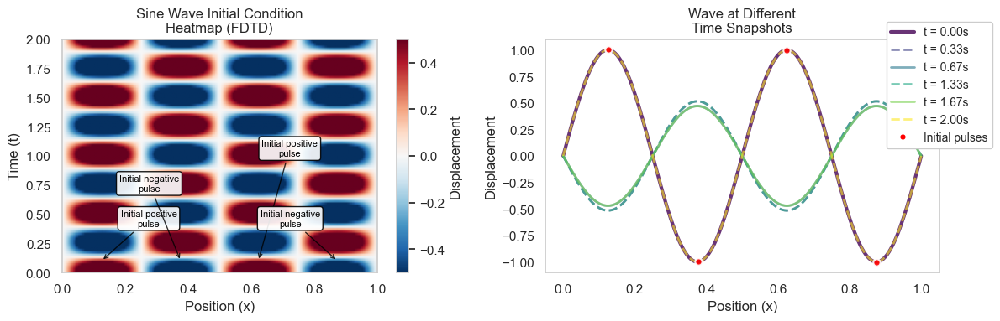

Detected 4 initial pulse(s):
  Pulse 1: position x = 0.126, amplitude = 1.000
  Pulse 2: position x = 0.623, amplitude = 1.000
  Pulse 3: position x = 0.377, amplitude = -1.000
  Pulse 4: position x = 0.874, amplitude = -1.000


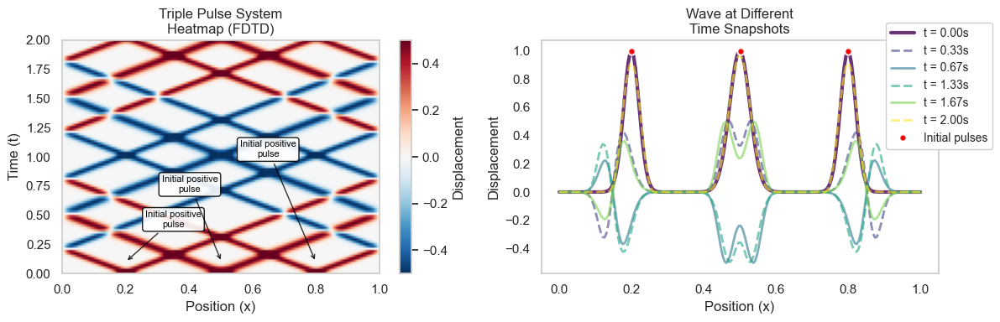

Detected 3 initial pulse(s):
  Pulse 1: position x = 0.201, amplitude = 0.999
  Pulse 2: position x = 0.503, amplitude = 0.996
  Pulse 3: position x = 0.799, amplitude = 0.999


In [7]:
# Now you can use it with the solve_wave_equation function:

# Example 1: Standard wave with Dirichlet boundaries
u1, x1, t1 = solve_wave_equation(boundary_type='dirichlet')
heatmap(u1, x1, t1, "Dirichlet Boundaries")

# Example 2: Damped wave with free boundaries  
u2, x2, t2 = solve_wave_equation(boundary_type='neumann', damping=0.01)
heatmap(u2, x2, t2, "Damped Wave (Neumann)")

# Example 3: Custom initial condition
def double_pulse(x):
    return gaussian_pulse(x, 0.3, 0.05) - gaussian_pulse(x, 0.7, 0.05)

u3, x3, t3 = solve_wave_equation(initial_condition=double_pulse)
heatmap(u3, x3, t3, "Colliding Opposite Pulses")

# Example 4: Sine wave initial condition
u4, x4, t4 = solve_wave_equation(initial_condition=sine_wave)
heatmap(u4, x4, t4, "Sine Wave Initial Condition")

# Example 5: Triple pulse
def triple_pulse(x):
    return (gaussian_pulse(x, 0.2, 0.03) + 
            gaussian_pulse(x, 0.5, 0.04) + 
            gaussian_pulse(x, 0.8, 0.03))

u5, x5, t5 = solve_wave_equation(initial_condition=triple_pulse)
heatmap(u5, x5, t5, "Triple Pulse System")

### Animations of time evolution

Below, a function is written to show the time evolution of wave propagation for different initial conditions and boundary types. These animations help visualize how pulses travel, reflect, and interact in the 1D wave equation. You can observe features such as:

- **Propagation:** Pulses move through the domain at constant speed.
- **Reflection:** At fixed (Dirichlet) or free (Neumann) boundaries, waves reflect with characteristic phase changes.
- **Damping:** With nonzero damping, wave amplitudes decrease over time.
- **Superposition:** Multiple pulses can collide and pass through each other, illustrating the linearity of the wave equation.

Use the controls below each animation to play, pause, or scrub through time. Initial pulse locations are marked for reference.

In [8]:
def create_wave_animation(u, x, t, title="Wave Animation", show_initial_pulses=True):
    """
    Create an enhanced wave animation with pulse markers and time evolution.
    
    Parameters:
    -----------
    u : ndarray
        Wave field data from solve_wave_equation
    x : ndarray  
        Spatial coordinates
    t : ndarray
        Time coordinates
    title : str
        Animation title
    show_initial_pulses : bool
        Whether to show initial pulse positions
    """
    
    # Extract parameters
    Nt, Nx = u.shape
    L = x[-1] - x[0]
    
    # Detect initial pulses if requested
    pulse_positions = []
    pulse_amplitudes = []
    
    if show_initial_pulses:
        from scipy.signal import find_peaks
        initial_field = u[0, :]
        pulse_threshold = 0.1 * np.max(np.abs(initial_field))
        
        pos_peaks, _ = find_peaks(initial_field, height=pulse_threshold)
        neg_peaks, _ = find_peaks(-initial_field, height=pulse_threshold)
        
        for peak_idx in pos_peaks:
            pulse_positions.append(x[peak_idx])
            pulse_amplitudes.append(initial_field[peak_idx])
        
        for peak_idx in neg_peaks:
            pulse_positions.append(x[peak_idx])
            pulse_amplitudes.append(initial_field[peak_idx])
    
    # Set up figure
    fig, ax = plt.subplots(figsize=(8, 3))
    
    # Main wave line
    line, = ax.plot(x, u[0], lw=3, color='xkcd:water blue', label='Wave')
    
    # Initial pulse markers
    pulse_markers = []
    if pulse_positions:
        for pos, amp in zip(pulse_positions, pulse_amplitudes):
            marker, = ax.plot(pos, amp, 'o', markerfacecolor='red', 
                            markeredgecolor='white', markersize=8, 
                            markeredgewidth=2, alpha=0.7)
            pulse_markers.append(marker)
    
    # Styling
    ax.set_ylim(-1.2, 1.2)
    ax.set_xlim(0, L)
    ax.set_xlabel("Position (x)")
    ax.set_ylabel("Displacement u(x,t)")
    ax.grid(False)
    ax.set_title(title)
    
    # Time and info display
    info_text = ax.text(0.02, 0.95, '', transform=ax.transAxes, fontsize=11,
                       bbox=dict(boxstyle="round,pad=0.4", facecolor='white', alpha=0.9))
    
    # Legend
    legend_elements = [line]
    if pulse_positions:
        legend_elements.append(plt.Line2D([0], [0], marker='o', color='w', 
                                        markerfacecolor='red', markeredgecolor='white',
                                        markersize=8, label='Initial pulses'))
    ax.legend(handles=legend_elements, loc='upper right', frameon=False)
    
    def animate(frame):
        """Animation update function."""
        # Update wave line
        line.set_ydata(u[frame])
        
        # Update info display
        current_time = t[frame]
        max_displacement = np.max(np.abs(u[frame]))
        info_text.set_text(f'Time: {current_time:.3f} s\nMax |u|: {max_displacement:.2f}')
        
        # Fade initial pulse markers over time
        if pulse_markers:
            fade_factor = max(0, 1 - current_time / (t[-1] * 0.3))  # Fade over first 30% of simulation
            for marker in pulse_markers:
                marker.set_alpha(0.7 * fade_factor)
        
        return [line, info_text] + pulse_markers
    
    # Create animation
    frame_skip = max(1, Nt // 200)
    ani = FuncAnimation(fig, animate, frames=range(0, Nt, frame_skip),
                       interval=50, blit=True, repeat=True)
    
    plt.tight_layout()
    return ani, fig


In [10]:
# Create an animation for any wave simulation
animation, figure = create_wave_animation(u3, x3, t3, "FDTD Wave Simulation")

# For Jupyter notebook HTML display:
plt.close(figure)
HTML(animation.to_jshtml())